In [ ]:
def load_data(FILEID):
    #FILEID es la identificación de un archivo .zip en mi drive con permisos para cualquiera que posea el ID
    ## dicho ID se encuentra en celdas más abajo.
    #Se carga, descomprime y finalmente guarda en la variable Data el conjunto de datos.
    !wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id='$FILEID -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id="$FILEID -O parches.zip && rm -rf /tmp/cookies.txt
    !unzip parches.zip
    !dir
    #Data=df.read_csv('/content/UpdatedResumeDataSet.csv')
    

In [2]:
load_data('1MNxr-FFnz2RIurEpQgQg6m377DdqsZZY')

--2024-11-29 05:07:39--  https://docs.google.com/uc?export=download&confirm=&id=1MNxr-FFnz2RIurEpQgQg6m377DdqsZZY
Resolving docs.google.com (docs.google.com)... 172.217.218.102, 172.217.218.139, 172.217.218.113, ...
Connecting to docs.google.com (docs.google.com)|172.217.218.102|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1MNxr-FFnz2RIurEpQgQg6m377DdqsZZY&export=download [following]
--2024-11-29 05:07:39--  https://drive.usercontent.google.com/download?id=1MNxr-FFnz2RIurEpQgQg6m377DdqsZZY&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 142.250.145.132, 2a00:1450:4013:c14::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|142.250.145.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 18197214 (17M) [application/octet-stream]
Saving to: ‘parches.zip’

parches.zip         100%[===================>]  17.35M   

In [3]:
%matplotlib inline
from PIL import Image
from skimage.io import imread, imshow, show
import scipy.fftpack as fp
from scipy import ndimage, misc, signal
from skimage import data, img_as_float
from skimage.color import rgb2gray
from skimage.transform import rescale
import matplotlib.pylab as pylab
import numpy as np
import numpy.fft
import timeit
import numpy as np
from scipy import signal, misc, ndimage
from skimage import filters, feature, img_as_float
from skimage.io import imread
from skimage.color import rgb2gray
from PIL import Image, ImageFilter
import matplotlib.pylab as pylab

#Gradients

1.0 -1.0 -0.003003003003003003
1.0 -1.0 -0.002890173410404624


<ipython-input-4-c780a5f51feb>:16: RuntimeWarning: divide by zero encountered in divide
  im_dir = np.arctan(im_y/im_x)
<ipython-input-4-c780a5f51feb>:16: RuntimeWarning: invalid value encountered in divide
  im_dir = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

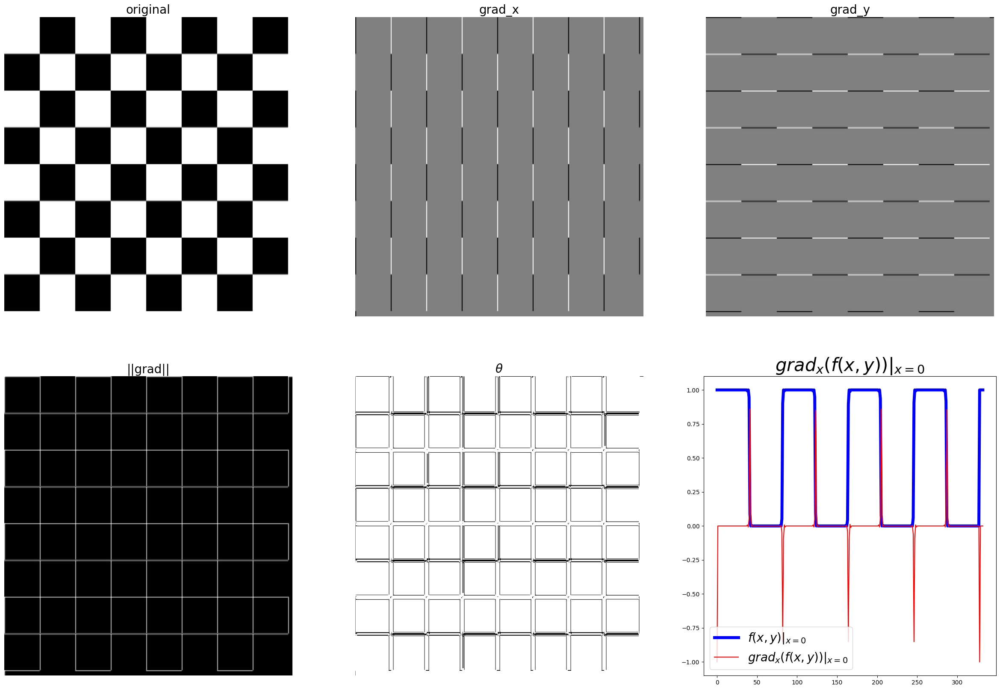

In [4]:
import matplotlib.pyplot as plt
import numpy as np
from skimage.color import rgb2gray
from skimage.io import imread
def plot_image(image, title):
    pylab.imshow(image), pylab.title(title, size=20), pylab.axis('off')
path = '/content/images/'
ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = rgb2gray(imread(path + 'chess.png')[:, :, 0:3])
im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
print(im_x.max(),im_x.min(),im_x.mean())
print(im_y.max(),im_y.min(),im_y.mean())
im_mag = np.sqrt(im_x**2 + im_y**2)
im_dir = np.arctan(im_y/im_x)
pylab.gray()
pylab.figure(figsize=(30,20))
pylab.subplot(231), plot_image(im, 'original'), pylab.subplot(232),
plot_image(im_x, 'grad_x')
pylab.subplot(233), plot_image(im_y, 'grad_y'), pylab.subplot(234),
plot_image(im_mag, '||grad||')
pylab.subplot(235), plot_image(im_dir, r'$\theta$'), pylab.subplot(236)
pylab.plot(range(im.shape[1]), im[0,:], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
pylab.plot(range(im.shape[1]), im_x[0,:], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
pylab.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
pylab.legend(prop={'size': 20})
pylab.show()


1.0


<ipython-input-5-b179f1ae2912>:15: RuntimeWarning: divide by zero encountered in divide
  im_ang = np.arctan(im_y/im_x)
<ipython-input-5-b179f1ae2912>:15: RuntimeWarning: invalid value encountered in divide
  im_ang = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

/usr/local/lib/python3.10/dist-packages/matplotlib/cm.py:489: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


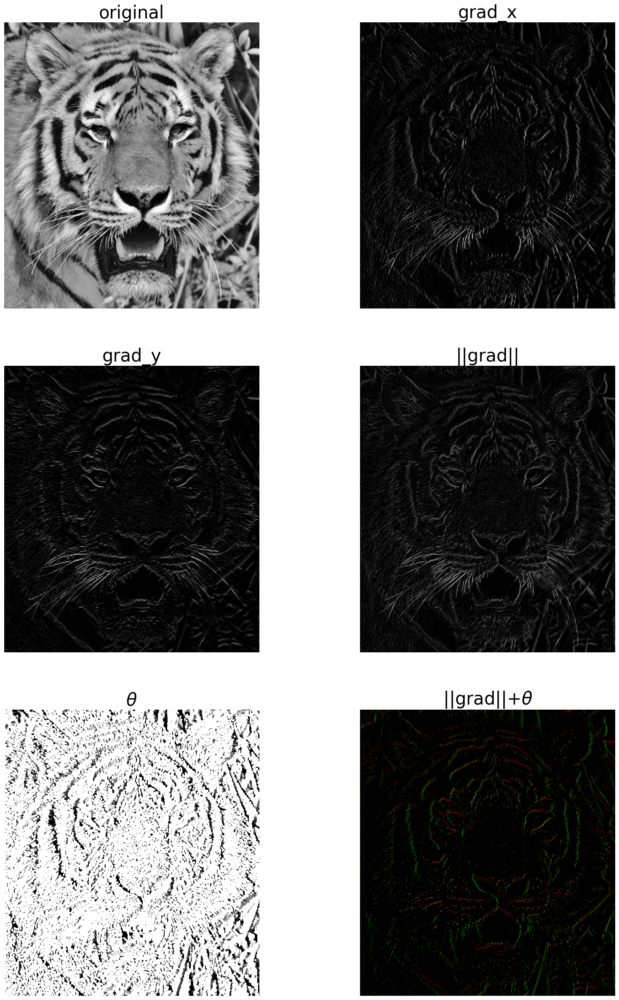

In [5]:
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.util import random_noise
from skimage.filters import gaussian
import matplotlib.pylab as plt
from scipy import signal
import numpy as np
ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = rgb2gray(imread(path+'tiger3.jpg'))
print(np.max(im))
im_x = np.clip(signal.convolve2d(im, ker_x, mode='same'),0,1)
im_y = np.clip(signal.convolve2d(im, ker_y, mode='same'),0,1)
im_mag = np.sqrt(im_x**2 + im_y**2)
im_ang = np.arctan(im_y/im_x)
plt.gray()
plt.figure(figsize=(20,30))
plt.subplot(321)
plt.imshow(im)
plt.title('original', size=30)
plt.axis('off')
plt.subplot(322)
plt.imshow(im_x)
plt.title('grad_x', size=30)
plt.axis('off')
plt.subplot(323)
plt.imshow(im_y)
plt.title('grad_y', size=30)
plt.axis('off')
plt.subplot(324)
plt.imshow(im_mag)
plt.title('||grad||', size=30)
plt.axis('off')
plt.subplot(325)
plt.imshow(im_ang)
plt.title(r'$\theta$', size=30)
plt.axis('off')
plt.subplot(326)
im = np.zeros((im.shape[0],im.shape[1],3))
im[...,0] = im_mag*np.sin(im_ang)
im[...,1] = im_mag*np.cos(im_ang)
plt.imshow(im)
plt.title(r'||grad||+$\theta$', size=30)
plt.axis('off')
plt.show()

# Laplacian

<Figure size 640x480 with 0 Axes>

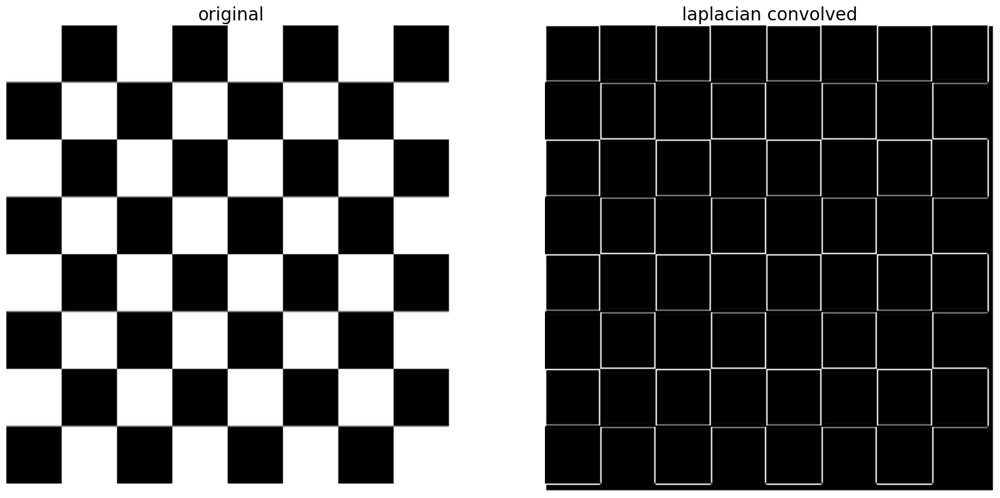

In [6]:
ker_laplacian = [[0,-1,0],[-1, 4, -1],[0,-1,0]]
im = rgb2gray(imread(path+'chess.png')[:,:,0:3])
im1 = np.clip(signal.convolve2d(im, ker_laplacian, mode='same'),0,1)
pylab.gray()
pylab.figure(figsize=(20,10))
pylab.subplot(121), plot_image(im, 'original')
pylab.subplot(122), plot_image(im1, 'laplacian convolved')
pylab.show()

# Effects of noise on gradient computation

1.0000000000000004


<ipython-input-7-3f124cf543d3>:21: RuntimeWarning: divide by zero encountered in divide
  im_ang = np.arctan(im_y/im_x)
<ipython-input-7-3f124cf543d3>:21: RuntimeWarning: invalid value encountered in divide
  im_ang = np.arctan(im_y/im_x)


<Figure size 640x480 with 0 Axes>

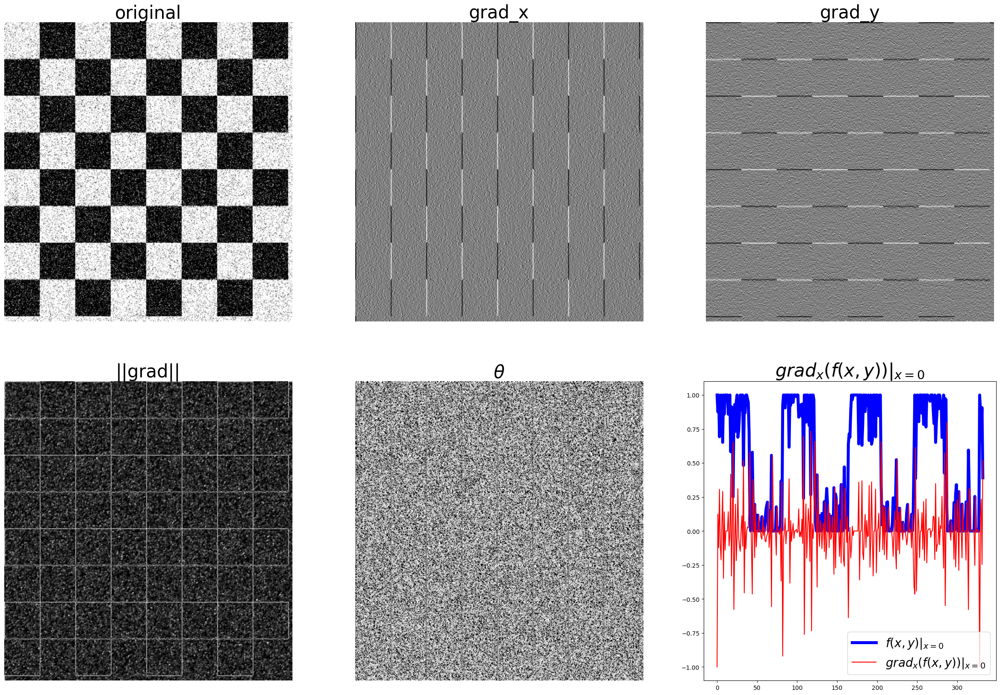

In [7]:
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.util import random_noise
from skimage.filters import gaussian
import matplotlib.pylab as plt
from scipy import signal
import numpy as np
ker_x = [[-1, 1]]
ker_y = [[-1], [1]]
im = rgb2gray(imread(path+'chess.png')[:,:,0:3])
sigma = 0.25
sign = np.random.random(im.shape)
sign[sign <= 0.5] = -1
sign[sign > 0.5] = 1
im = random_noise(im, var=sigma**2)
im = gaussian(im, sigma=0.25)
print(np.max(im))
im_x = signal.convolve2d(im, ker_x, mode='same')
im_y = signal.convolve2d(im, ker_y, mode='same')
im_mag = np.sqrt(im_x**2 + im_y**2)
im_ang = np.arctan(im_y/im_x)
plt.gray()
plt.figure(figsize=(30,20))
plt.subplot(231)
plt.imshow(im)
plt.title('original', size=30)
plt.axis('off')
plt.subplot(232)
plt.imshow(im_x)
plt.title('grad_x', size=30)
plt.axis('off')
plt.subplot(233)
plt.imshow(im_y)
plt.title('grad_y', size=30)
plt.axis('off')
plt.subplot(234)
plt.imshow(im_mag)
plt.title('||grad||', size=30)
plt.axis('off')
plt.subplot(235)
plt.imshow(im_ang)
plt.title(r'$\theta$', size=30)
plt.axis('off')
plt.subplot(236)
plt.plot(range(im.shape[1]), im[0,:], 'b-', label=r'$f(x,y)|_{x=0}$', linewidth=5)
plt.plot(range(im.shape[1]), im_x[0,:], 'r-', label=r'$grad_x (f(x,y))|_{x=0}$')
plt.title(r'$grad_x (f(x,y))|_{x=0}$', size=30)
plt.legend(prop={'size': 20})
plt.show()

# Sharpening with Laplacian

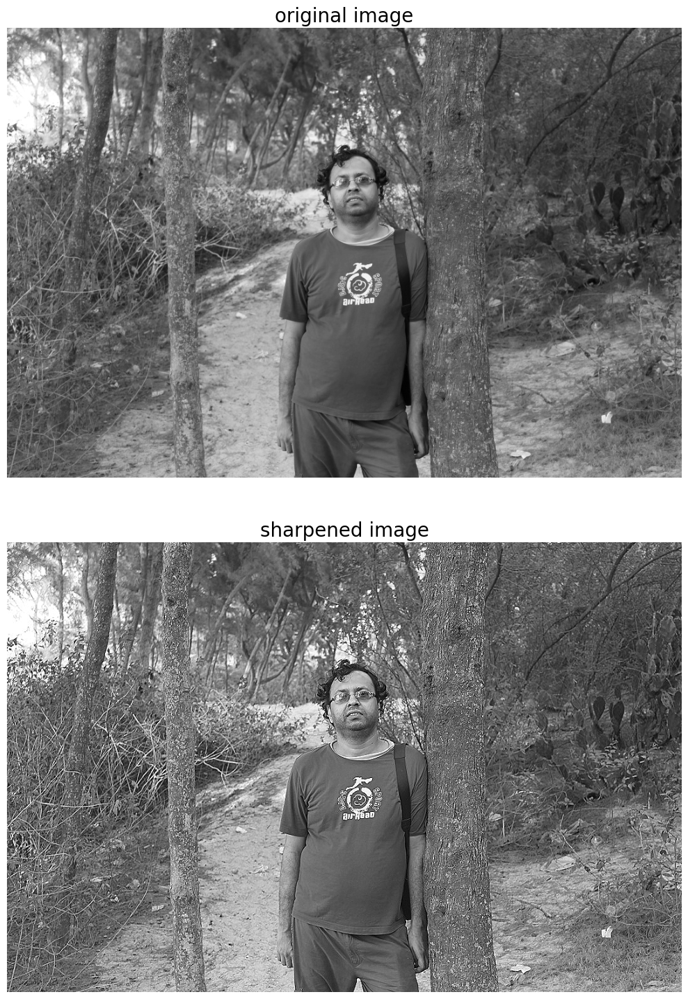

In [8]:
from skimage.filters import laplace
im = rgb2gray(imread(path+'me8.JPG'))
im1 = np.clip(laplace(im) + im, 0, 1)
pylab.figure(figsize=(10,15))
pylab.subplot(211), plot_image(im, 'original image')
pylab.subplot(212), plot_image(im1, 'sharpened image')
pylab.tight_layout()
pylab.show()

# Sobel edge detector with scikit-image

<Figure size 640x480 with 0 Axes>

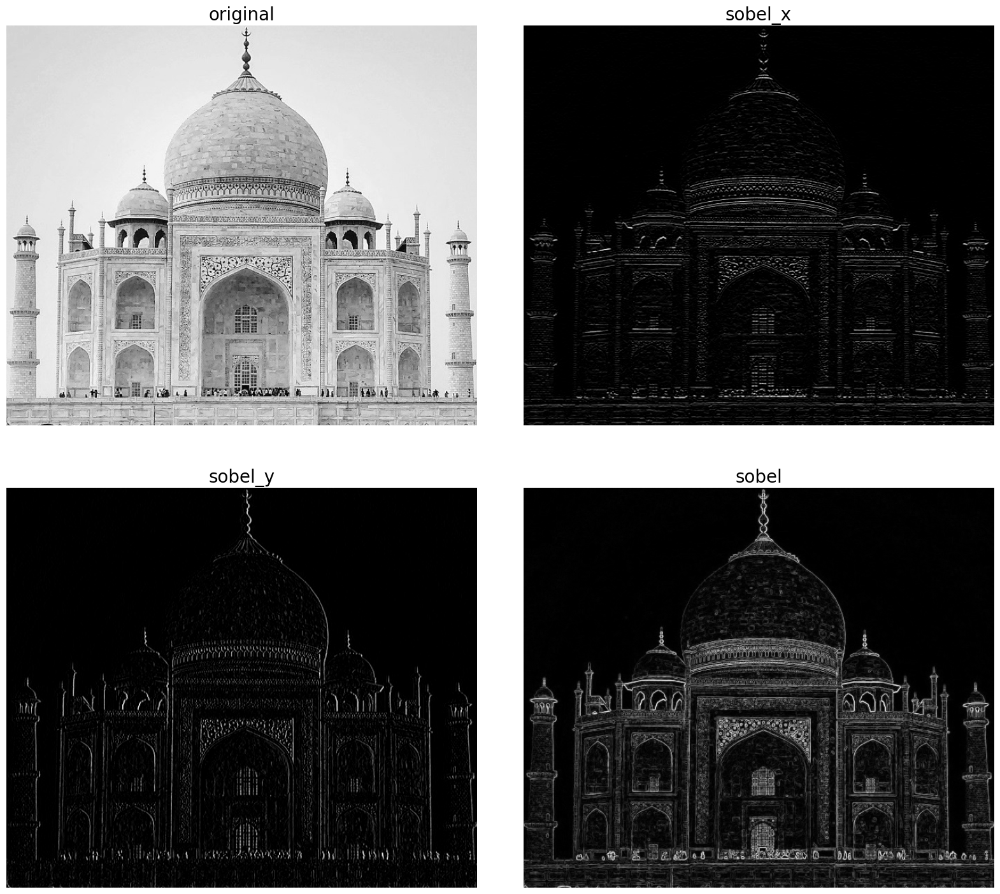

In [9]:
im = rgb2gray(imread(path+'tajmahal1.jpg')) # RGB image to gray scale
pylab.gray()
pylab.figure(figsize=(20,18))
pylab.subplot(2,2,1)
plot_image(im, 'original')
pylab.subplot(2,2,2)
edges_x = filters.sobel_h(im)
plot_image(np.clip(edges_x,0,1), 'sobel_x')
pylab.subplot(2,2,3)
edges_y = filters.sobel_v(im)
plot_image(np.clip(edges_y,0,1), 'sobel_y')
pylab.subplot(2,2,4)
edges = filters.sobel(im)
plot_image(np.clip(edges,0,1), 'sobel')
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()

# Different edge detectors with scikit-image – Prewitt, Roberts, Sobel, Scharr, and Laplace

<Figure size 640x480 with 0 Axes>

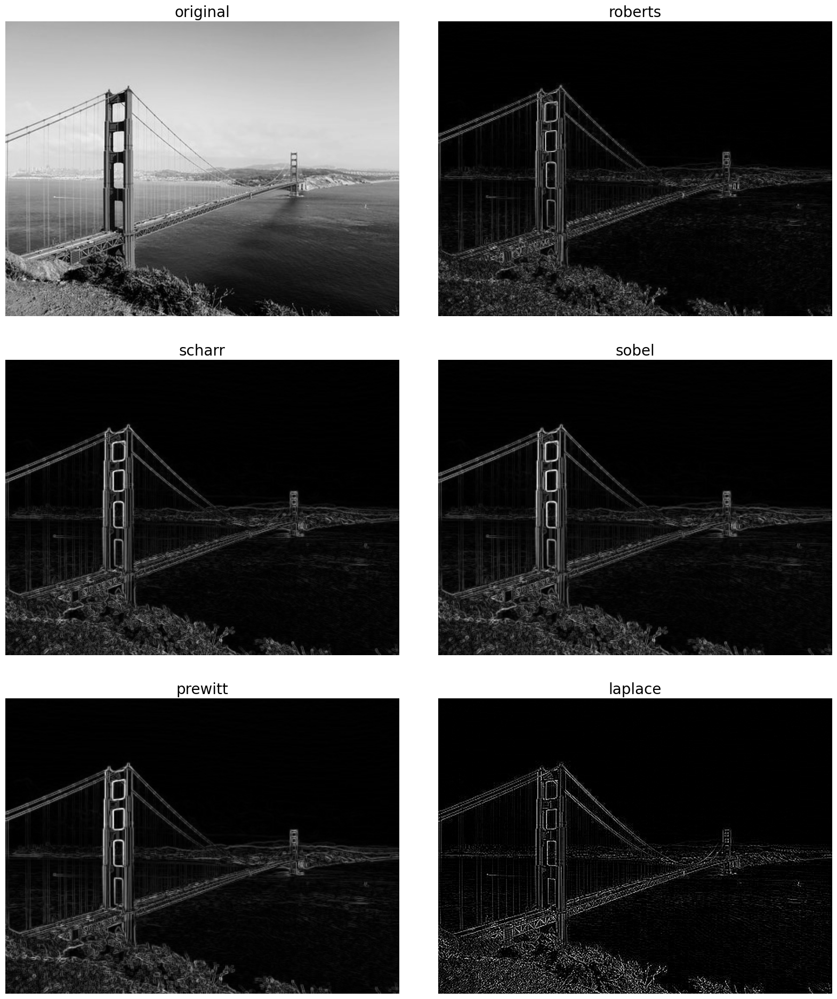

In [10]:
im = rgb2gray(imread(path+'goldengate.jpg')) # RGB image to gray scale
pylab.gray()
pylab.figure(figsize=(20,24))
pylab.subplot(3,2,1), plot_image(im, 'original')
edges = filters.roberts(im)
pylab.subplot(3,2,2), plot_image(edges, 'roberts')
edges = filters.scharr(im)
pylab.subplot(3,2,3), plot_image(edges, 'scharr')
edges = filters.sobel(im)
pylab.subplot(3,2,4), plot_image(edges, 'sobel')
edges = filters.prewitt(im)
pylab.subplot(3,2,5), plot_image(edges, 'prewitt')
edges = np.clip(filters.laplace(im), 0, 1)
pylab.subplot(3,2,6), plot_image(edges, 'laplace')
pylab.subplots_adjust(wspace=0.1, hspace=0.1)
pylab.show()

##Kernels


$\textbf{Prewitt}$
\begin{equation}
\textbf{X=} \quad
\
\begin{bmatrix}
-1 & 0 & 1 \\
-1 & 0 & 1 \\
-1 & 0 & 1
\end{bmatrix}
\quad
\textbf{Y=}
\begin{bmatrix}
-1 & -1 & -1 \\
0 & 0 & 0 \\
1 & 1 & 1
\end{bmatrix}
\
\end{equation}

$\textbf{Roberts}$
\begin{equation}
\textbf{X=} \quad
\
\begin{bmatrix}
1 & 0  \\
0 & -1  \\
\end{bmatrix}
\quad
\textbf{Y=}
\begin{bmatrix}
0 & 1 \\
-1 & 0  \\
\end{bmatrix}
\
\end{equation}

$\textbf{Sobel}$
\begin{equation}
\textbf{X=} \quad
\
\begin{bmatrix}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1
\end{bmatrix}
\quad
\textbf{Y=}
\begin{bmatrix}
-1 & -2 & -1 \\
0 & 0 & 0 \\
1 & 2 & 1
\end{bmatrix}
\
\end{equation}




$\textbf{Scharr}$
\begin{equation}
\textbf{X=} \quad
\
\begin{bmatrix}
-3 & 0 & 3 \\
-10 & 0 & 10 \\
-3 & 0 & 3
\end{bmatrix}
\quad
\textbf{Y=}
\begin{bmatrix}
-3 & -10 & -3 \\
0 & 0 & 0 \\
3 & 10 & 3
\end{bmatrix}
\
\end{equation}

$\textbf{Laplace}$
\begin{equation}
\textbf{X=} \quad
\
\begin{bmatrix}
0 & 1 & 0 \\
1 & 4 & 1 \\
0 & 1 & 0
\end{bmatrix}
\quad
\
\end{equation}

# The Canny edge detector with scikit-image

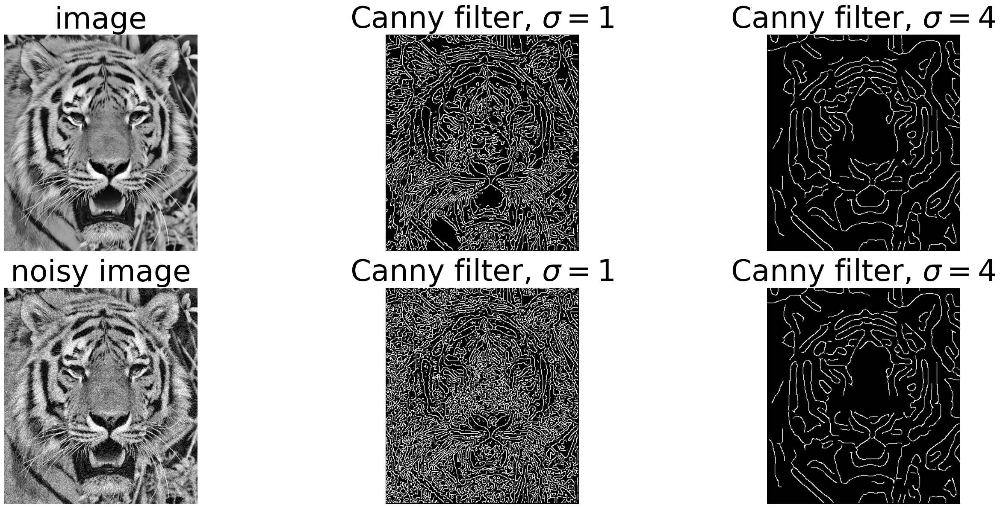

In [11]:
import numpy as np
import pylab
from skimage.color import rgb2gray
from skimage.io import imread
from skimage.util import random_noise
from skimage.filters import gaussian
from skimage.feature import canny

# Cargar la imagen

im = rgb2gray(imread(path+'tiger3.jpg'))

# Agregar ruido
sigma = 0.1
sign = np.random.random(im.shape)
sign[sign <= 0.5] = -1
sign[sign > 0.5] = 1
im1 = random_noise(im, var=sigma**2)
im1 = gaussian(im1, sigma=sigma)

# Aplicar el detector de bordes Canny
edges1 = canny(im)
edges2 = canny(im, sigma=4)

# Crear la matriz de subfiguras (2 filas, 3 columnas)
fig, axes = pylab.subplots(nrows=2, ncols=3, figsize=(30, 12), sharex=True, sharey=True)

# Mostrar las imágenes en las subfiguras
axes[0, 0].imshow(im, cmap=pylab.cm.gray)
axes[0, 0].axis('off')
axes[0, 0].set_title('image', fontsize=50)

axes[0, 1].imshow(edges1, cmap=pylab.cm.gray)
axes[0, 1].axis('off')
axes[0, 1].set_title('Canny filter, $\sigma=1$', fontsize=50)

axes[0, 2].imshow(edges2, cmap=pylab.cm.gray)
axes[0, 2].axis('off')
axes[0, 2].set_title('Canny filter, $\sigma=4$', fontsize=50)
edges1 = canny(im1)
edges2 = canny(im1, sigma=4)
axes[1, 0].imshow(im1, cmap=pylab.cm.gray)
axes[1, 0].axis('off')
axes[1, 0].set_title('noisy image', fontsize=50)

axes[1, 1].imshow(edges1, cmap=pylab.cm.gray)
axes[1, 1].axis('off')
axes[1, 1].set_title('Canny filter, $\sigma=1$', fontsize=50)

axes[1, 2].imshow(edges2, cmap=pylab.cm.gray)
axes[1, 2].axis('off')
axes[1, 2].set_title('Canny filter, $\sigma=4$', fontsize=50)

fig.tight_layout()
pylab.show()


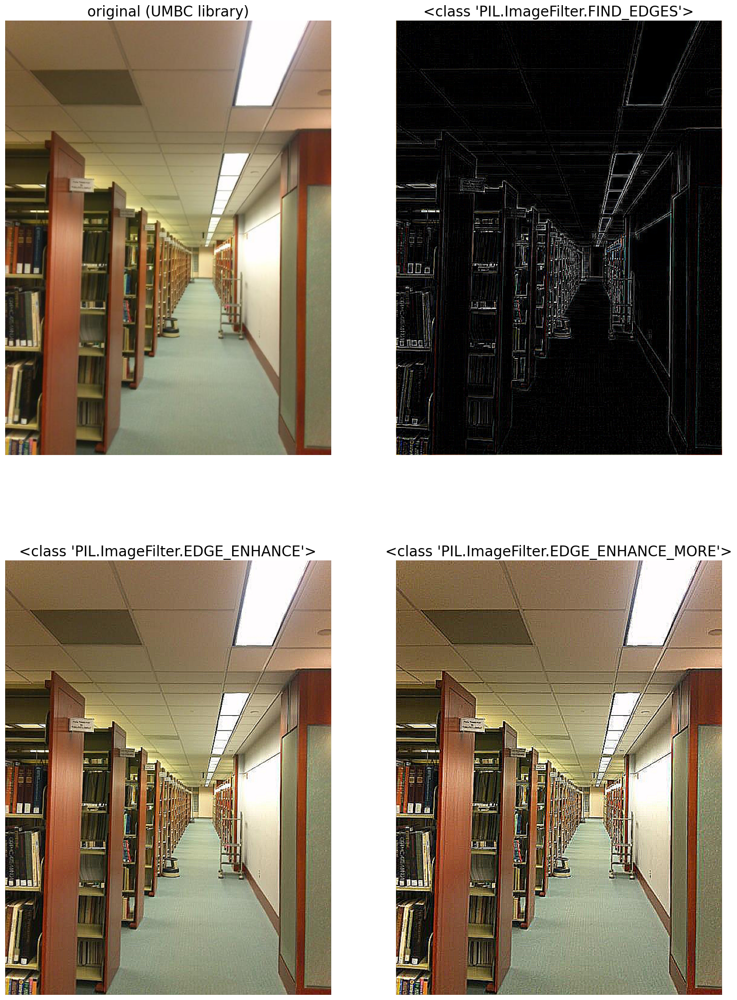

In [12]:
from PIL.ImageFilter import (FIND_EDGES, EDGE_ENHANCE, EDGE_ENHANCE_MORE)
im = Image.open(path+'umbc_lib.jpg')
pylab.figure(figsize=(18,25))
pylab.subplot(2,2,1)
plot_image(im, 'original (UMBC library)')
i = 2
for f in (FIND_EDGES, EDGE_ENHANCE, EDGE_ENHANCE_MORE):
    pylab.subplot(2,2,i)
    im1 = im.filter(f)
    plot_image(im1, str(f))
    i += 1
pylab.show()

#Segunda parte

In [13]:
%matplotlib inline
from PIL import Image
path = '/content/images/'

from skimage.io import imread, imshow, show
import scipy.fftpack as fp
from scipy import ndimage, misc, signal
from skimage import data, img_as_float
from skimage.color import rgb2gray
from skimage.transform import rescale
import matplotlib.pylab as pylab
import numpy as np
import numpy.fft
import timeit
import numpy as np
from scipy import signal, misc, ndimage
from skimage import filters, feature, img_as_float
from skimage.io import imread
from skimage.color import rgb2gray
from PIL import Image, ImageFilter
import matplotlib.pylab as pylab

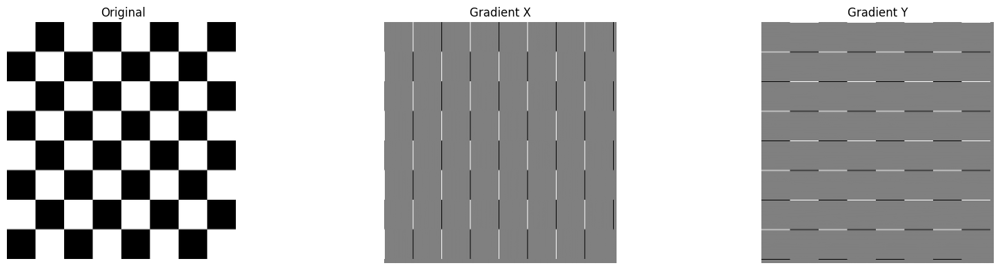

In [14]:
import matplotlib.pyplot as plt
import numpy as np
from skimage.color import rgb2gray
from skimage.io import imread
from numpy.fft import fft2, fftshift, ifft2, ifftshift

def plot_image(image, title):
    plt.imshow(image, cmap='gray')
    plt.title(title)
    plt.axis('off')

# Cargar y convertir la imagen a escala de grises
# Asegúrate de que 'path' esté correctamente definido y 'chess.png' esté en la ubicación correcta
im = rgb2gray(imread(path + 'chess.png')[:, :, :3])

# Tamaños de la imagen
rows, cols = im.shape

# Crear los filtros en el dominio espacial
ker_x = np.array([[-1, 1]])
ker_y = np.array([[-1], [1]])

# Ajustar el tamaño de los kernels al de la imagen
ker_x_padded = np.pad(ker_x, ((0, rows - ker_x.shape[0]), (0, cols - ker_x.shape[1])), 'constant')
ker_y_padded = np.pad(ker_y, ((0, rows - ker_y.shape[0]), (0, cols - ker_y.shape[1])), 'constant')

# Transformar imagen y kernels al dominio de la frecuencia
im_f = fftshift(fft2(im))
ker_x_f = fftshift(fft2(ker_x_padded))
ker_y_f = fftshift(fft2(ker_y_padded))

# Multiplicar en el dominio de la frecuencia
im_x_f = im_f * ker_x_f
im_y_f = im_f * ker_y_f

# Transformar de vuelta al dominio espacial
im_x = np.real(ifft2(ifftshift(im_x_f)))
im_y = np.real(ifft2(ifftshift(im_y_f)))

# Calcular magnitud y dirección del gradiente

# Plotting
plt.figure(figsize=(20, 10))
subplots = [im, im_x, im_y]
titles = ['Original', 'Gradient X', 'Gradient Y']
for i, subplot in enumerate(subplots, start=1):
    plt.subplot(2, 3, i)
    plot_image(subplot, titles[i-1])

plt.show()


(224, 225)


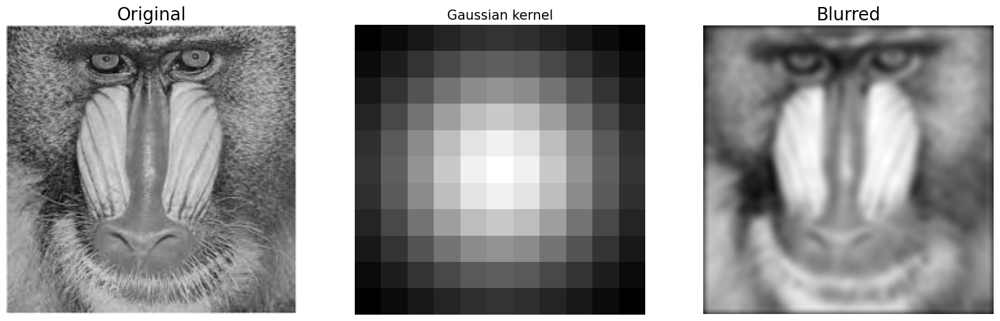

In [15]:
from scipy.signal.windows import gaussian
im = np.mean(imread(path+'mandrill.jpg'), axis=2)
print(im.shape)
# (224, 225)
gauss_kernel = np.outer(gaussian(11, 3),gaussian(11, 3)) # 2D Gaussian kernel of size 11x11 with σ = 3
im_blurred = signal.fftconvolve(im, gauss_kernel, mode='same')
fig, (ax_original, ax_kernel, ax_blurred) = pylab.subplots(1, 3, figsize=(20,8))
ax_original.imshow(im, cmap='gray')
ax_original.set_title('Original', size=20)
ax_original.set_axis_off()
ax_kernel.imshow(gauss_kernel)
ax_kernel.set_title('Gaussian kernel', size=15)
ax_kernel.set_axis_off()
ax_blurred.imshow(im_blurred, cmap='gray')
ax_blurred.set_title('Blurred', size=20)
ax_blurred.set_axis_off()
fig.show()

(224, 225)


(<Axes: title={'center': 'ffconvolve Output'}>,
 Text(0.5, 1.0, 'ffconvolve Output'),
 (-0.5, 224.5, 223.5, -0.5))

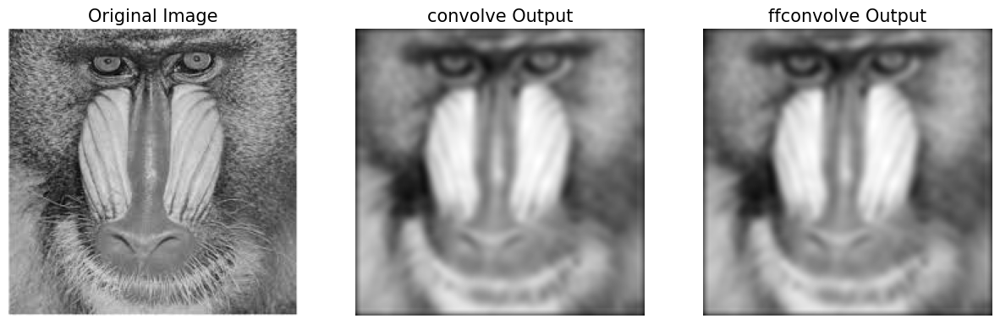

In [16]:
im = np.mean(imread(path+'mandrill.jpg'), axis=2)
print(im.shape)
# (224, 225)
gauss_kernel = np.outer(gaussian(11, 3),gaussian(11, 3)) # 2D Gaussian kernel of size 11x11 with σ = 3
im_blurred1 = signal.convolve(im, gauss_kernel, mode="same")
im_blurred2 = signal.fftconvolve(im, gauss_kernel, mode='same')
def wrapper_convolve(func):
    def wrapped_convolve():
        return func(im, gauss_kernel, mode="same")
    return wrapped_convolve
wrapped_convolve = wrapper_convolve(signal.convolve)
wrapped_fftconvolve = wrapper_convolve(signal.fftconvolve)
times1 = timeit.repeat(wrapped_convolve, number=100, repeat=100)
times2 = timeit.repeat(wrapped_fftconvolve, number=100, repeat=100)
pylab.figure(figsize=(15,5))
pylab.gray()
pylab.subplot(131), pylab.imshow(im), pylab.title('Original Image',size=15), pylab.axis('off')
pylab.subplot(132), pylab.imshow(im_blurred1), pylab.title('convolve Output', size=15), pylab.axis('off')
pylab.subplot(133), pylab.imshow(im_blurred2), pylab.title('ffconvolve Output', size=15),pylab.axis('off')

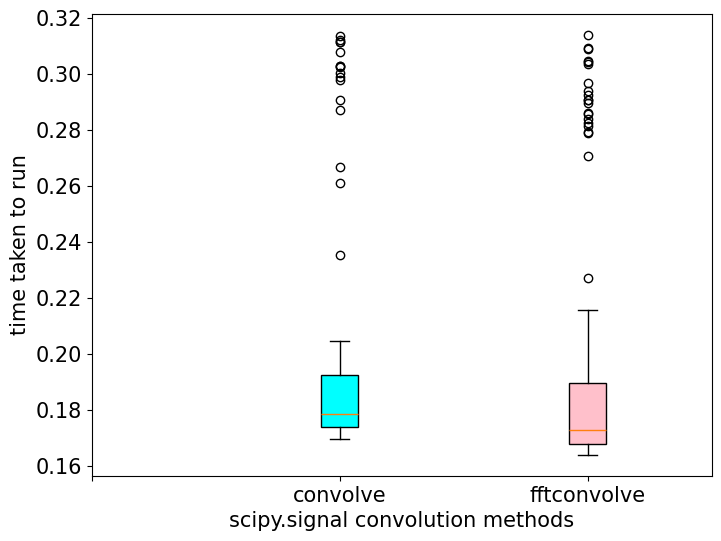

In [17]:
data = [times1, times2]
pylab.figure(figsize=(8,6))
box = pylab.boxplot(data, patch_artist=True) #notch=True,
colors = ['cyan', 'pink']
for patch, color in zip(box['boxes'], colors):
    patch.set_facecolor(color)
pylab.xticks(np.arange(3), ('', 'convolve', 'fftconvolve'), size=15)
pylab.yticks(fontsize=15)
pylab.xlabel('scipy.signal convolution methods', size=15)
pylab.ylabel('time taken to run', size = 15)
pylab.show()

## High-Pass Filter (HPF)

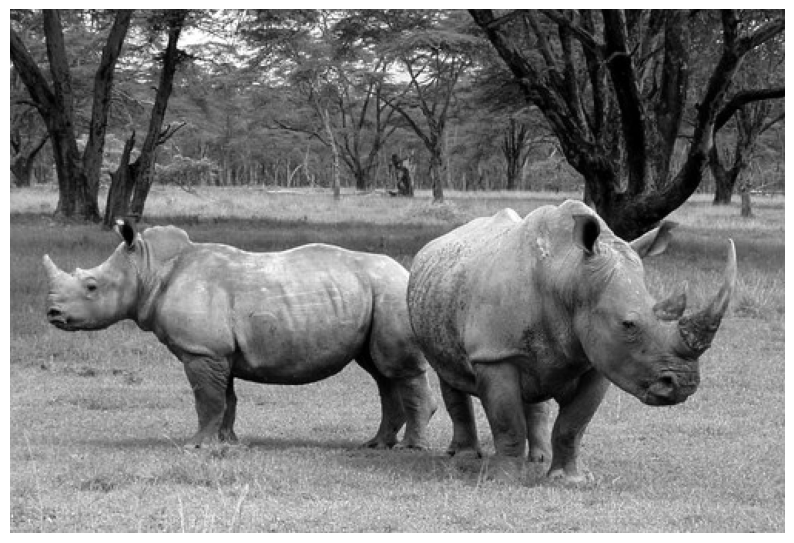

(<Figure size 1000x1000 with 1 Axes>,
 (-0.5, 502.5, 339.5, -0.5),
 None)

In [18]:
im = np.array(Image.open(path+'rhino.jpg').convert('L'))
pylab.figure(figsize=(10,10)), pylab.imshow(im, cmap=pylab.cm.gray), pylab.axis('off'), pylab.show()

<ipython-input-19-50ba10e46e72>:6: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.figure(figsize=(10,10)), pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int)), pylab.show()


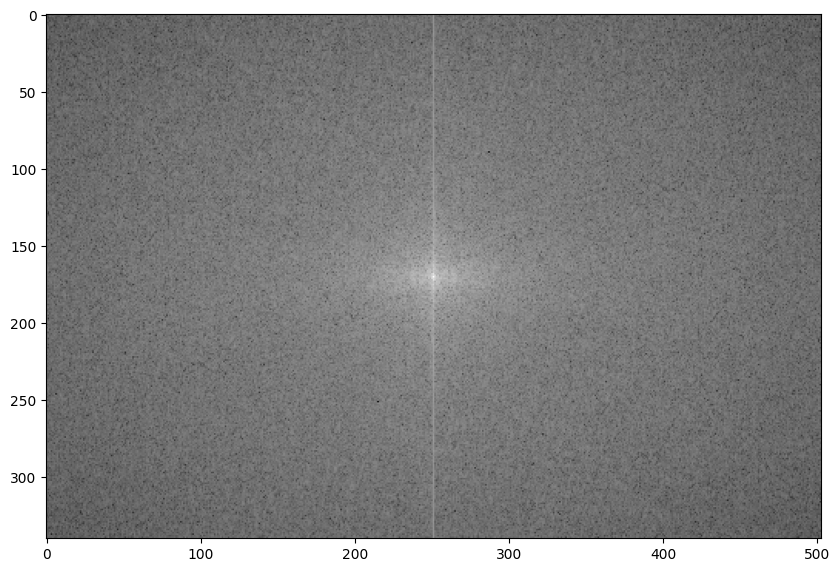

(14.322687097943962-19.54711239024453j) (145.8341051232988+0j)
(-1152486.094777115-136452.40318145222j) (19575157-0j)


In [19]:
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)
freq1 = np.copy(freq)
freq2 = fp.fftshift(freq1)
pylab.figure(figsize=(10,10)), pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int)), pylab.show()
print((20*np.log10( 0.1 + freq2)).min(),(20*np.log10( 0.1 + freq2)).max())
print(freq2.min(),freq2.max())

<ipython-input-20-30c618c8c934>:4: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int))


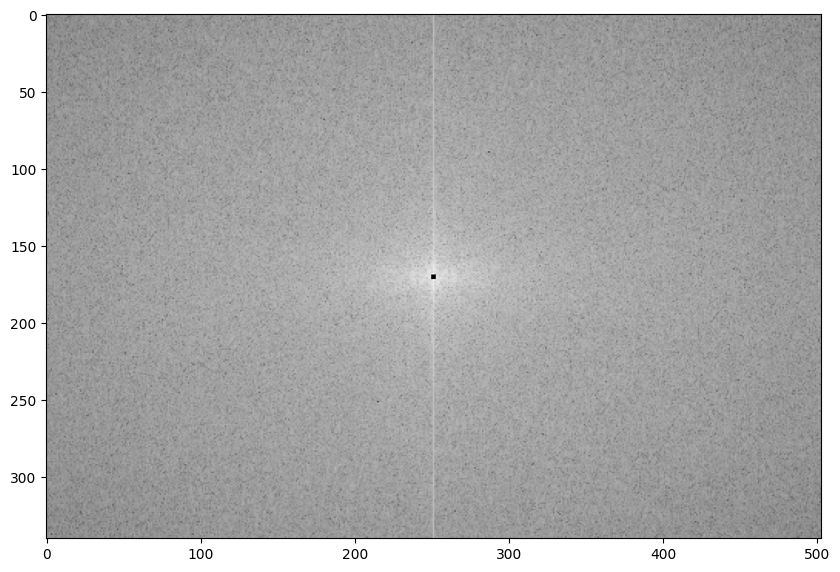

In [20]:
# apply HPF
freq2[half_w-1:half_w+2,half_h-1:half_h+2] = 0 # select all but the first 20x20 (low) frequencies
pylab.figure(figsize=(10,10))
pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int))
pylab.show()

0.6942592805984057
2.0323399414159278


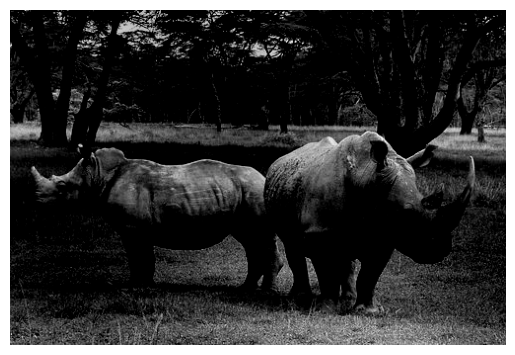

(<matplotlib.image.AxesImage at 0x7e01fbbcf6d0>,
 (-0.5, 502.5, 339.5, -0.5),
 None)

In [21]:
import numpy as np
from scipy import fftpack
def signaltonoise(a, axis=0, ddof=0):
    a = np.asanyarray(a)
    m = a.mean(axis)
    sd = a.std(axis=axis, ddof=ddof)
    return np.where(sd == 0, 0, m/sd)
im1 = np.clip(fp.ifft2(fftpack.ifftshift(freq2)).real,0,255) # clip pixel values after IFFT
print(signaltonoise(im1, axis=None))
# 0.5901647786775175
print(signaltonoise(im, axis=None))
pylab.imshow(im1, cmap='gray'), pylab.axis('off'), pylab.show()

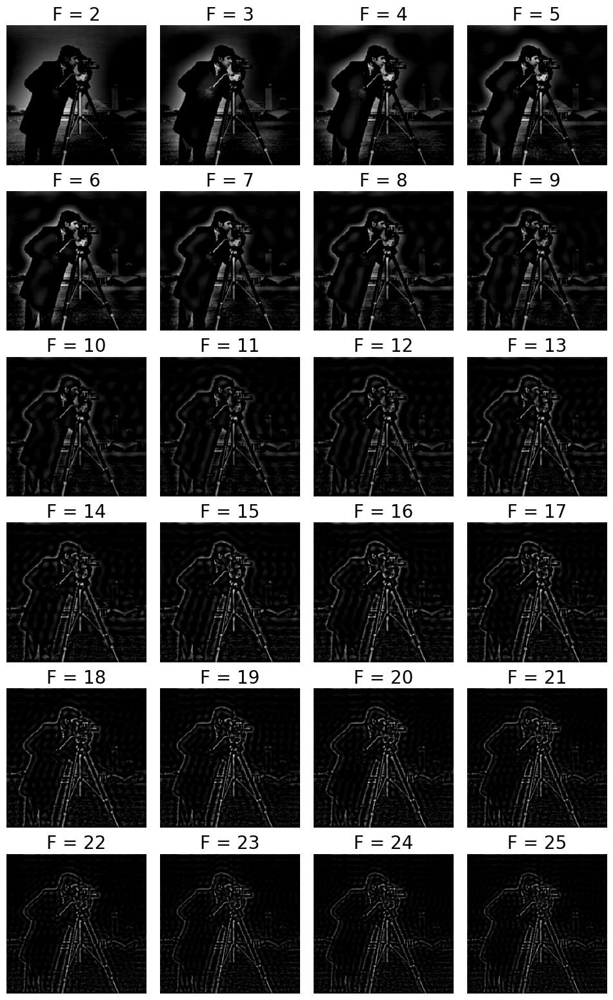

In [22]:
from scipy import fftpack
im = np.array(Image.open(path+'cameraman.jpg').convert('L'))
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)
snrs_hp = []
lbs = list(range(1,25))
pylab.figure(figsize=(12,20))
for l in lbs:
    freq1 = np.copy(freq)
    freq2 = fftpack.fftshift(freq1)
    freq2[half_w-l:half_w+l+1,half_h-l:half_h+l+1] = 0 # select all but the first lxl (low) frequencies
    im1 = np.clip(fp.ifft2(fftpack.ifftshift(freq2)).real,0,255) # clip pixel values after IFFT
    snrs_hp.append(signaltonoise(im1, axis=None))
    pylab.subplot(6,4,l), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
    pylab.title('F = ' + str(l+1), size=20)
pylab.subplots_adjust(wspace=0.1, hspace=0)
pylab.show()

# Low-pass filter (LPF)

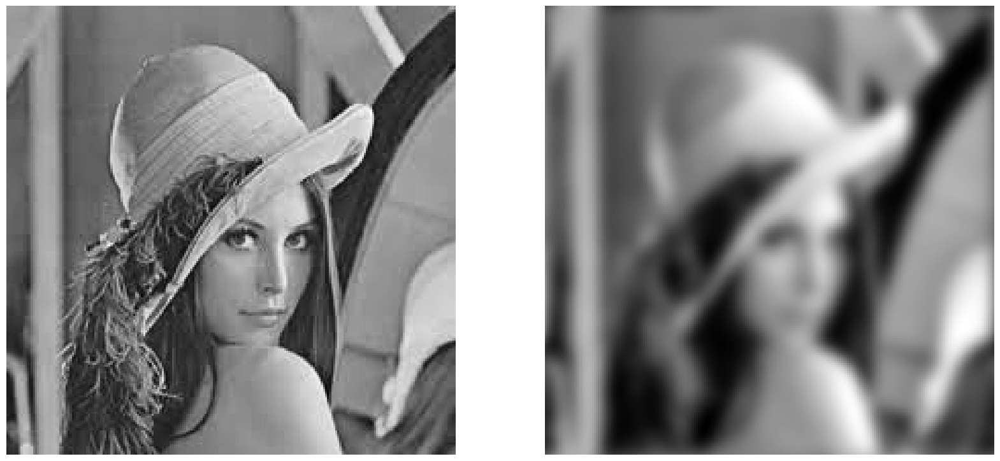

In [23]:
import numpy.fft as fp
fig, (axes1, axes2) = pylab.subplots(1, 2, figsize=(20,10))
pylab.gray() # show the result in grayscale
im = np.mean(imread(path+'lena.jpg'), axis=2)
freq = fp.fft2(im)
freq_gaussian = ndimage.fourier_gaussian(freq, sigma=4)
im1 = fp.ifft2(freq_gaussian)
axes1.imshow(im), axes1.axis('off'), axes2.imshow(im1.real) # the imaginary part is an artifact
axes2.axis('off')
pylab.show()

<ipython-input-24-ea0dc956bb4e>:3: ComplexWarning: Casting complex values to real discards the imaginary part
  numpy.fft.fftshift(freq_gaussian))).astype(int))


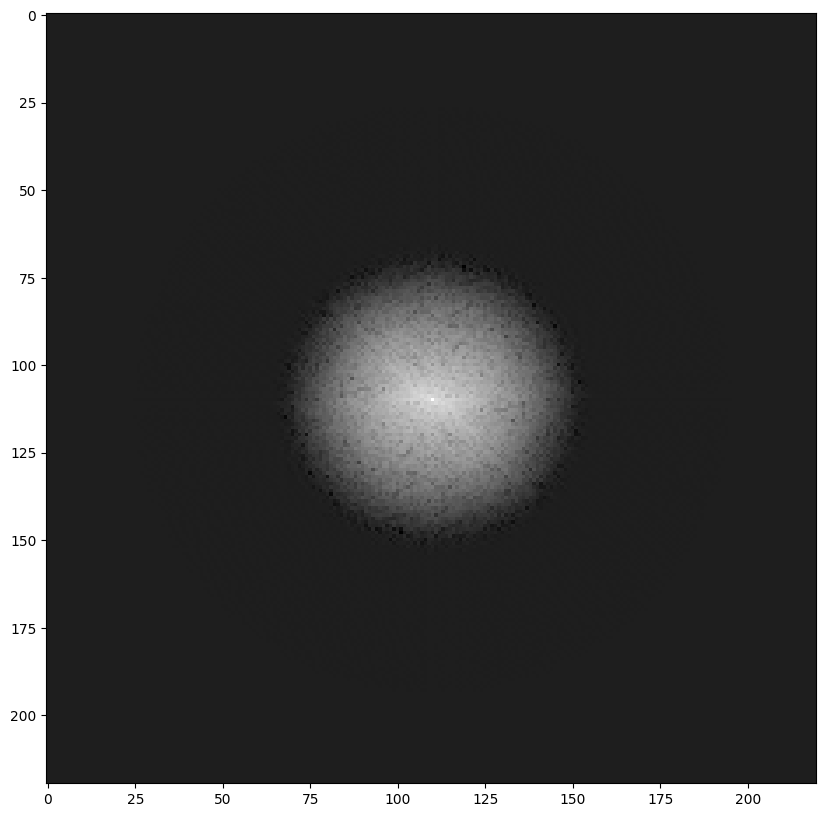

In [24]:
pylab.figure(figsize=(10,10))
pylab.imshow( (20*np.log10( 0.1 +
numpy.fft.fftshift(freq_gaussian))).astype(int))
pylab.show()

2.3990868903696403


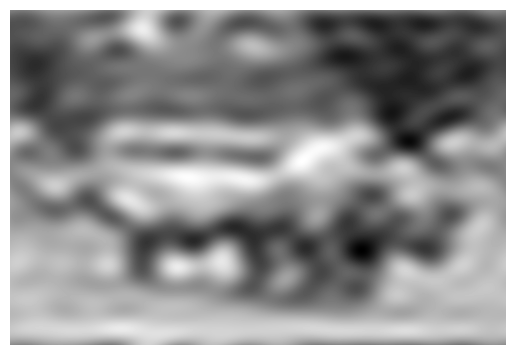

<ipython-input-25-f3f494033d55>:18: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int))


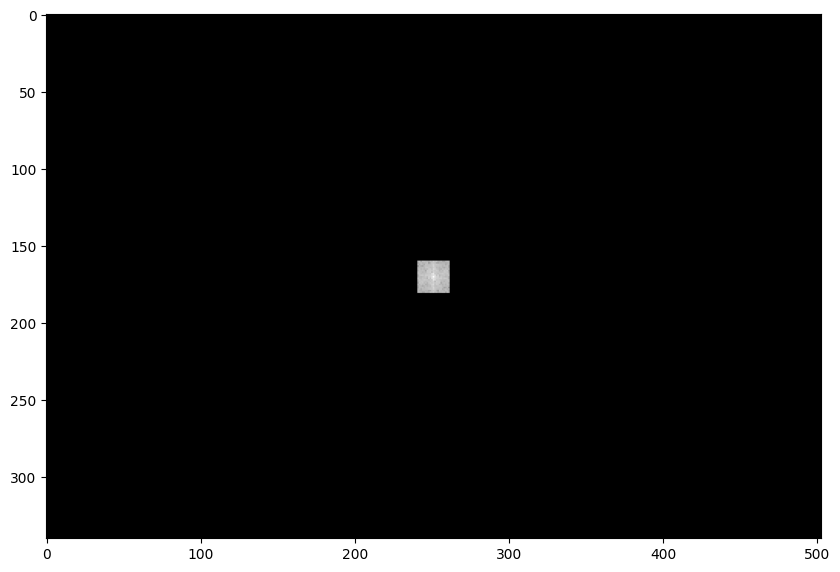

In [25]:
from scipy import fftpack
im = np.array(Image.open(path+'rhino.jpg').convert('L'))
# low pass filter
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)
freq1 = np.copy(freq)
freq2 = fftpack.fftshift(freq1)
freq2_low = np.copy(freq2)
freq2_low[half_w-10:half_w+11,half_h-10:half_h+11] = 0 # block the lowfrequencies
freq2 -= freq2_low # select only the first 20x20 (low) frequencies, block the high frequencies
im1 = fp.ifft2(fftpack.ifftshift(freq2)).real
print(signaltonoise(im1, axis=None))
# 2.389151856495427
pylab.imshow(im1, cmap='gray'), pylab.axis('off')
pylab.show()
pylab.figure(figsize=(10,10))
pylab.imshow( (20*np.log10( 0.1 + freq2)).astype(int))
pylab.show()

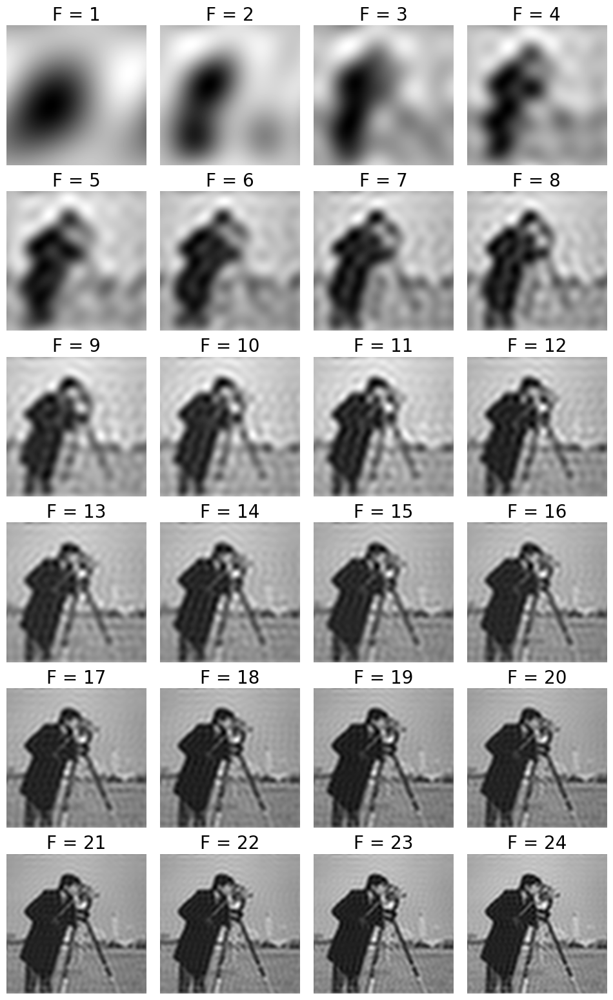

In [26]:
im = np.array(Image.open(path+'cameraman.jpg').convert('L'))
freq = fp.fft2(im)
(w, h) = freq.shape
half_w, half_h = int(w/2), int(h/2)
snrs_lp = []
ubs = list(range(1,25))
pylab.figure(figsize=(12,20))
for u in ubs:
    freq1 = np.copy(freq)
    freq2 = fftpack.fftshift(freq1)
    freq2_low = np.copy(freq2)
    freq2_low[half_w-u:half_w+u+1,half_h-u:half_h+u+1] = 0
    freq2 -= freq2_low # select only the first 20x20 (low) frequencies
    im1 = fp.ifft2(fftpack.ifftshift(freq2)).real
    snrs_lp.append(signaltonoise(im1, axis=None))
    pylab.subplot(6,4,u), pylab.imshow(im1, cmap='gray'), pylab.axis('off')
    pylab.title('F = ' + str(u), size=20)
pylab.subplots_adjust(wspace=0.1, hspace=0)
pylab.show()

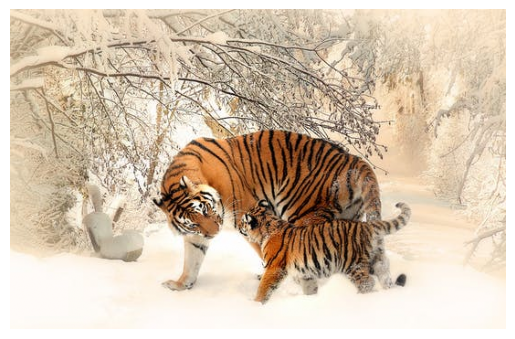

0.7832723415957195


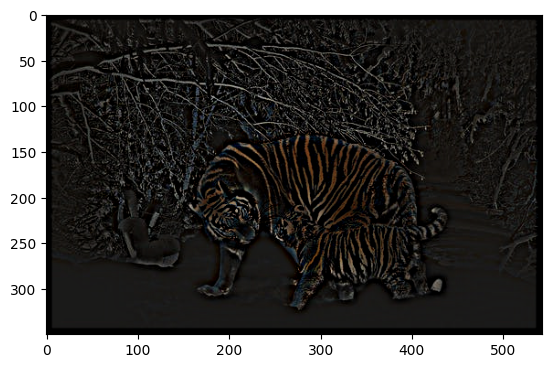

In [27]:
from skimage import img_as_float
im = img_as_float(pylab.imread(path+'tigers.jpeg'))
pylab.figure(), pylab.imshow(im), pylab.axis('off'), pylab.show()
x = np.linspace(-10, 10, 15)
kernel_1d = np.exp(-0.005*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel1 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
kernel_1d = np.exp(-5*x**2)
kernel_1d /= np.trapz(kernel_1d) # normalize the sum to 1
gauss_kernel2 = kernel_1d[:, np.newaxis] * kernel_1d[np.newaxis, :]
DoGKernel = gauss_kernel1[:, :, np.newaxis] - gauss_kernel2[:, :, np.newaxis]
im = signal.fftconvolve(im, DoGKernel, mode='same')
pylab.figure(), pylab.imshow(np.clip(im, 0, 1)), print(np.max(im)),
pylab.show()

(340, 453)


<ipython-input-28-0d429761df13>:9: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.subplot(2,2,2), pylab.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=pylab.cm.gray)
<ipython-input-28-0d429761df13>:20: ComplexWarning: Casting complex values to real discards the imaginary part
  pylab.subplot(2,2,4), pylab.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=pylab.cm.gray)


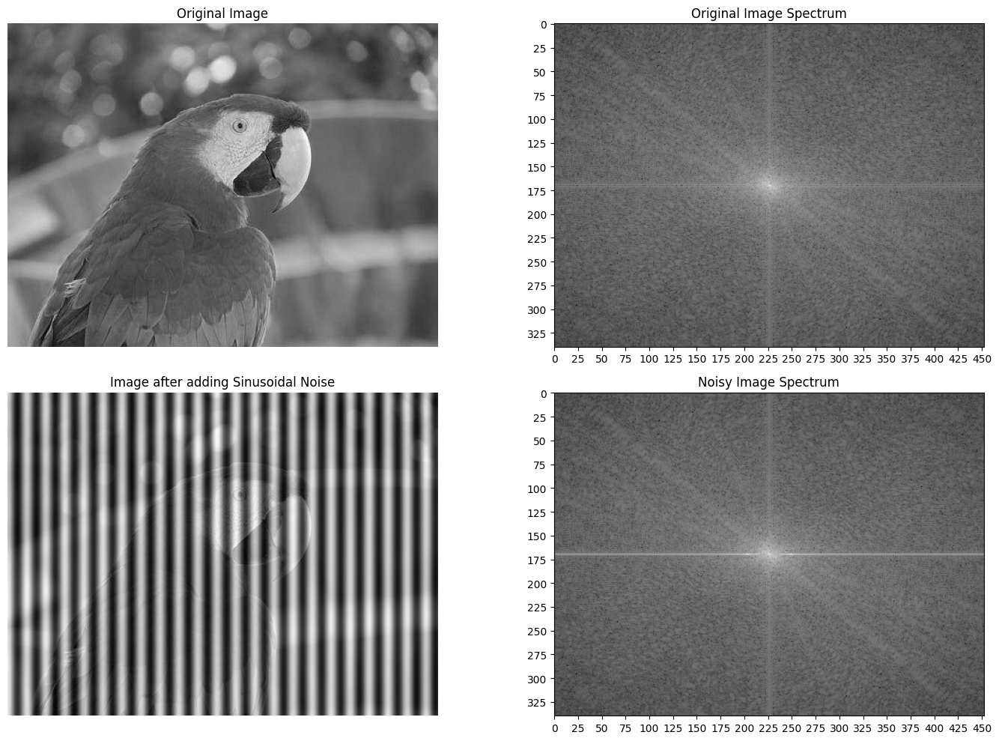

In [28]:
from scipy import fftpack
pylab.figure(figsize=(15,10))
im =  np.mean(imread(path+"parrot.png"), axis=2) / 255
print(im.shape)
pylab.subplot(2,2,1), pylab.imshow(im, cmap='gray'), pylab.axis('off')
pylab.title('Original Image')
F1 = fftpack.fft2((im).astype(float))
F2 = fftpack.fftshift( F1 )
pylab.subplot(2,2,2), pylab.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=pylab.cm.gray)
pylab.xticks(np.arange(0, im.shape[1], 25))
pylab.yticks(np.arange(0, im.shape[0], 25))
pylab.title('Original Image Spectrum')
# add periodic noise to the image
for n in range(im.shape[1]):
    im[:, n] += np.cos(0.1*np.pi*n)
pylab.subplot(2,2,3), pylab.imshow(im, cmap='gray'), pylab.axis('off')
pylab.title('Image after adding Sinusoidal Noise')
F1 = fftpack.fft2((im).astype(float)) # noisy spectrum
F2 = fftpack.fftshift( F1 )
pylab.subplot(2,2,4), pylab.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=pylab.cm.gray)
pylab.xticks(np.arange(0, im.shape[1], 25))
pylab.yticks(np.arange(0, im.shape[0], 25))
pylab.title('Noisy Image Spectrum')
pylab.tight_layout()
pylab.show()

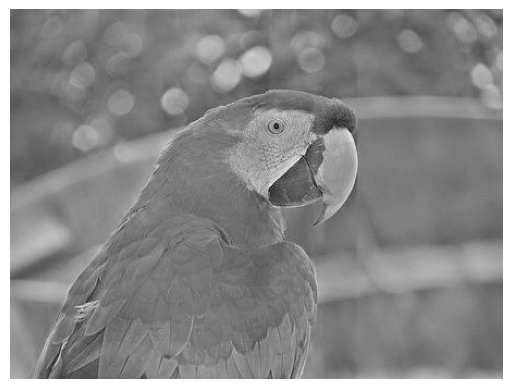

((0.0, 1.0, 0.0, 1.0), <matplotlib.image.AxesImage at 0x7e01fa64f9a0>, None)

In [29]:
F2[170:176,:230] = F2[170:176,230:] = 0 # eliminate the frequencies most likely responsible for noise (keep some low frequency components)
im1 = fftpack.ifft2(fftpack.ifftshift( F2 )).real
pylab.axis('off'), pylab.imshow(im1, cmap='gray'), pylab.show()

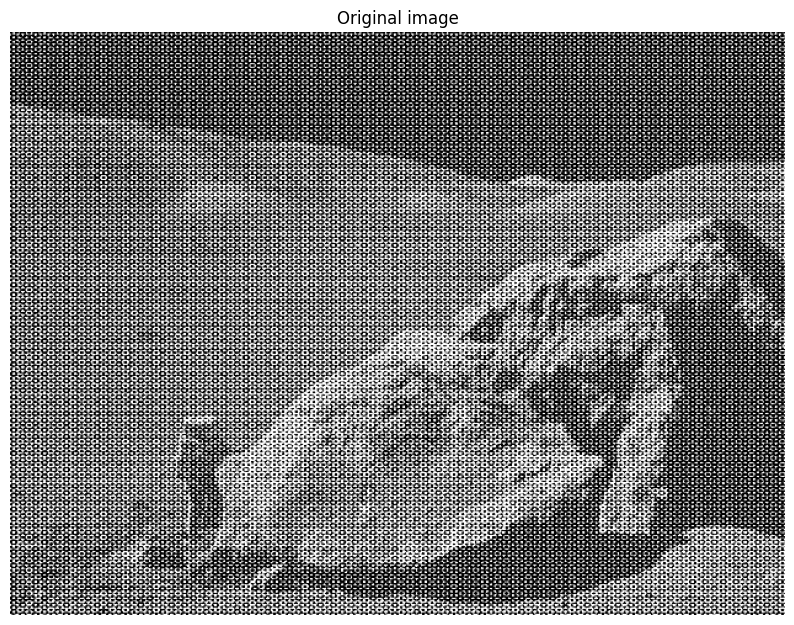

(<matplotlib.image.AxesImage at 0x7e01ff1ecdc0>,
 (-0.5, 629.5, 473.5, -0.5),
 Text(0.5, 1.0, 'Original image'),
 None)

In [30]:
im = pylab.imread(path+'moonlanding.png').astype(float)
pylab.figure(figsize=(10,10))
pylab.imshow(im, pylab.cm.gray), pylab.axis('off'), pylab.title('Original image'), pylab.show()

Text(0.5, 1.0, 'Spectrum with Fourier transform')

<Figure size 640x480 with 0 Axes>

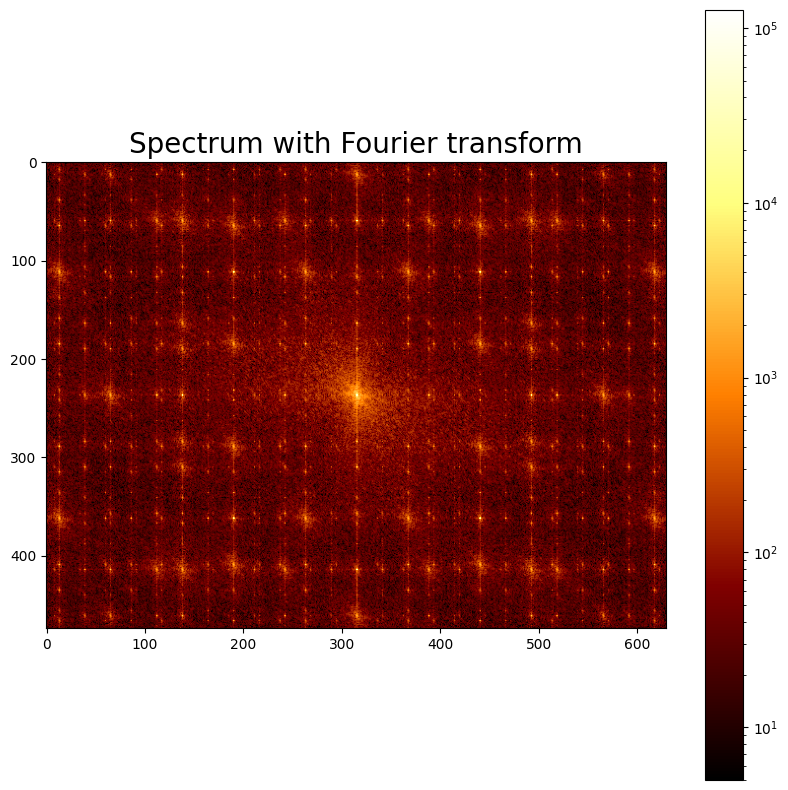

In [31]:
from scipy import fftpack
from matplotlib.colors import LogNorm
im_fft = fftpack.fft2(im)
def plot_spectrum(im_fft):
    pylab.figure(figsize=(10,10))
    pylab.imshow(np.abs(im_fft), norm=LogNorm(vmin=5), cmap=pylab.cm.afmhot), pylab.colorbar()
pylab.figure(), plot_spectrum(fftpack.fftshift(im_fft))
pylab.title('Spectrum with Fourier transform', size=20)

(<Figure size 640x480 with 0 Axes>, None, Text(0.5, 1.0, 'Filtered Spectrum'))

<Figure size 640x480 with 0 Axes>

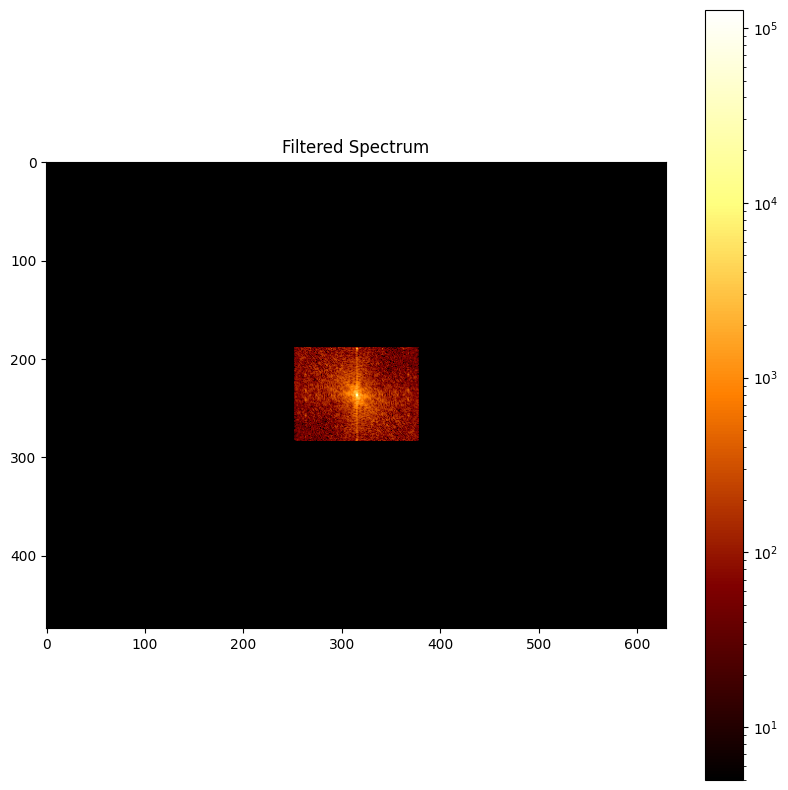

In [32]:
# Copy the original spectrum and truncate coefficients.
# Define the fraction of coefficients (in each direction) to keep as
keep_fraction = 0.1
im_fft2 = im_fft.copy()
# Set r and c to the number of rows and columns of the array.
r, c = im_fft2.shape
# Set all rows to zero with indices between r*keep_fraction and r*(1-keep_fraction)
im_fft2[int(r*keep_fraction):int(r*(1-keep_fraction))] = 1e-4
# Similarly with the columns
im_fft2[:, int(c*keep_fraction):int(c*(1-keep_fraction))] = 1e-4
pylab.figure(), plot_spectrum(fftpack.fftshift(im_fft2)),pylab.title('Filtered Spectrum')

Text(0.5, 1.0, 'Reconstructed Image')

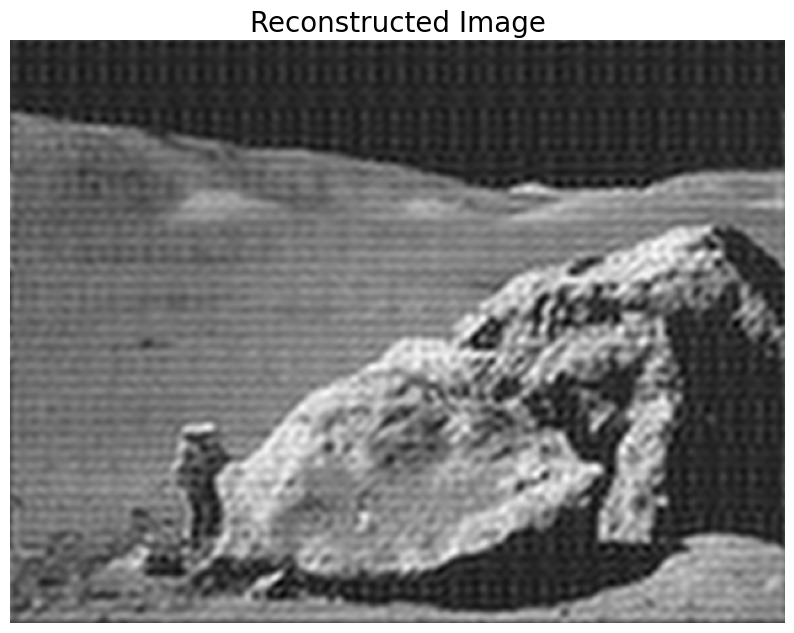

In [33]:
# Reconstruct the denoised image from the filtered spectrum, keep only the real part for display.
im_new = fp.ifft2(im_fft2).real
pylab.figure(figsize=(10,10)), pylab.imshow(im_new, pylab.cm.gray),
pylab.axis('off')
pylab.title('Reconstructed Image', size=20)